# Visualize learned features maps

In [1]:
import os
import torch
import torch.nn.functional as F

import matplotlib.pyplot as plt
%matplotlib inline

from chexpert import fetch_dataloader, densenet121, grad_cam, DenseNet

### Setup args to load data

In [2]:
class A:
    pass
args = A()
args.resize = False
args.mini_data = None
args.batch_size = 16
args.device = torch.device('cpu')
args.data_path = '/Users/Kamen/Data/'

In [3]:
valid_dataloader = fetch_dataloader(args, mode='valid')
n_classes = len(valid_dataloader.dataset.attr_names)

### Set up model and hooks for features to visualize

In [116]:
# densenet
if True:
    model = densenet121(num_classes=n_classes)
    checkpoint = torch.load('/Users/Kamen/Downloads/chexpert/results/densenet121_baseline/checkpoint_latest.pt', map_location='cpu')
else:
    model = DenseNet(32, (6, 12, 24, 16), 64, num_classes=n_classes,
                     attn_params={'k': 0.2, 'v': 0.1, 'nh': 8, 'relative': True,
                                  'input_dims': (320,320)})
    checkpoint = torch.load('/Users/Kamen/Downloads/chexpert/results/densenet121_attn_sgd/checkpoint_latest.pt', map_location='cpu')
model.load_state_dict(checkpoint['state_dict'])
print('Model trained to step: ', checkpoint['global_step'])

Model trained to step:  43500


In [117]:
# forward hooks
t1, t2, t3 = [], [], []
t1_handle = model.features.transition1.conv.register_forward_hook(lambda module, in_tensor, out_tensor: t1.append(out_tensor))
t2_handle = model.features.transition1.conv.register_forward_hook(lambda module, in_tensor, out_tensor: t2.append(out_tensor))
t3_handle = model.features.transition1.conv.register_forward_hook(lambda module, in_tensor, out_tensor: t3.append(out_tensor))

# backward hooks
bt1, bt2, bt3 = [], [], []
bt1_handle = model.features.transition1.conv.register_backward_hook(lambda module, in_tensor, out_tensor: bt1.append(in_tensor))
bt2_handle = model.features.transition1.conv.register_backward_hook(lambda module, in_tensor, out_tensor: bt2.append(in_tensor))
bt3_handle = model.features.transition1.conv.register_backward_hook(lambda module, in_tensor, out_tensor: bt3.append(in_tensor))

## Run example through model and visualize

In [118]:
x = next(iter(valid_dataloader))[0][0:1]  # first example only
out = model(x)

In [119]:
def visualize(features):
    fig, axs = plt.subplots(len(features)//12,12,figsize=(2*12,2*len(features)//12))
    for i, ax in enumerate(axs.flatten()):
        ax.imshow(features[i].detach().abs())
        ax.axis('off')

### Visualize features

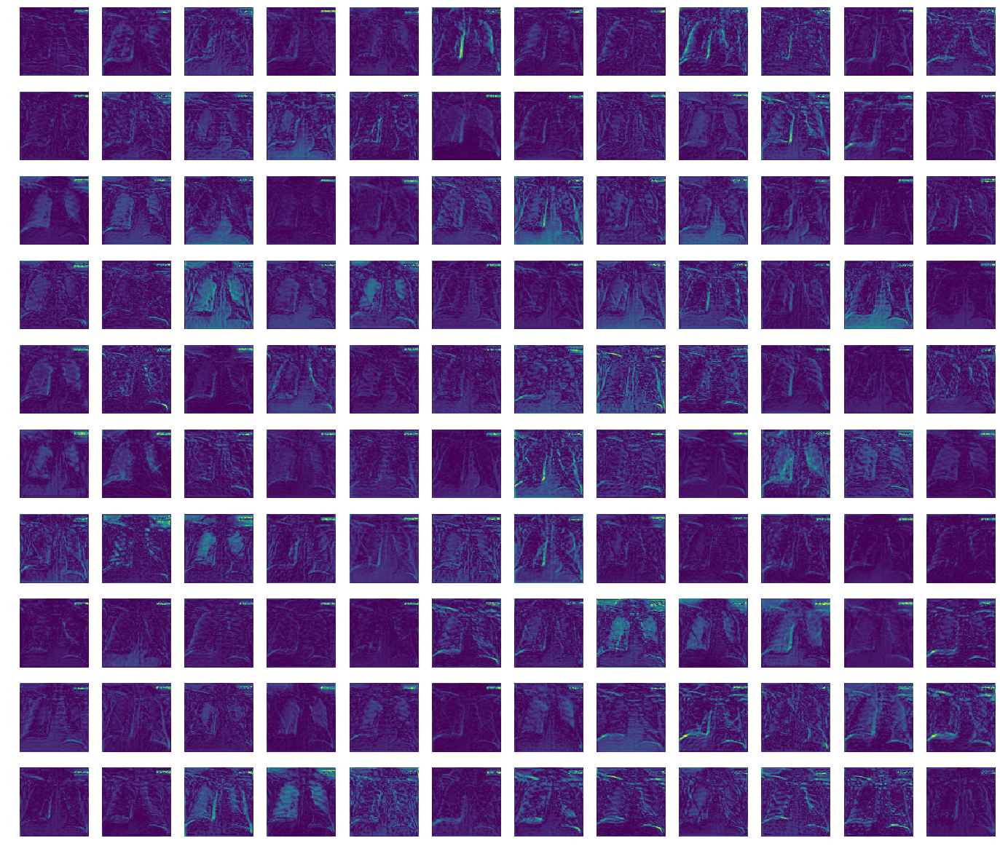

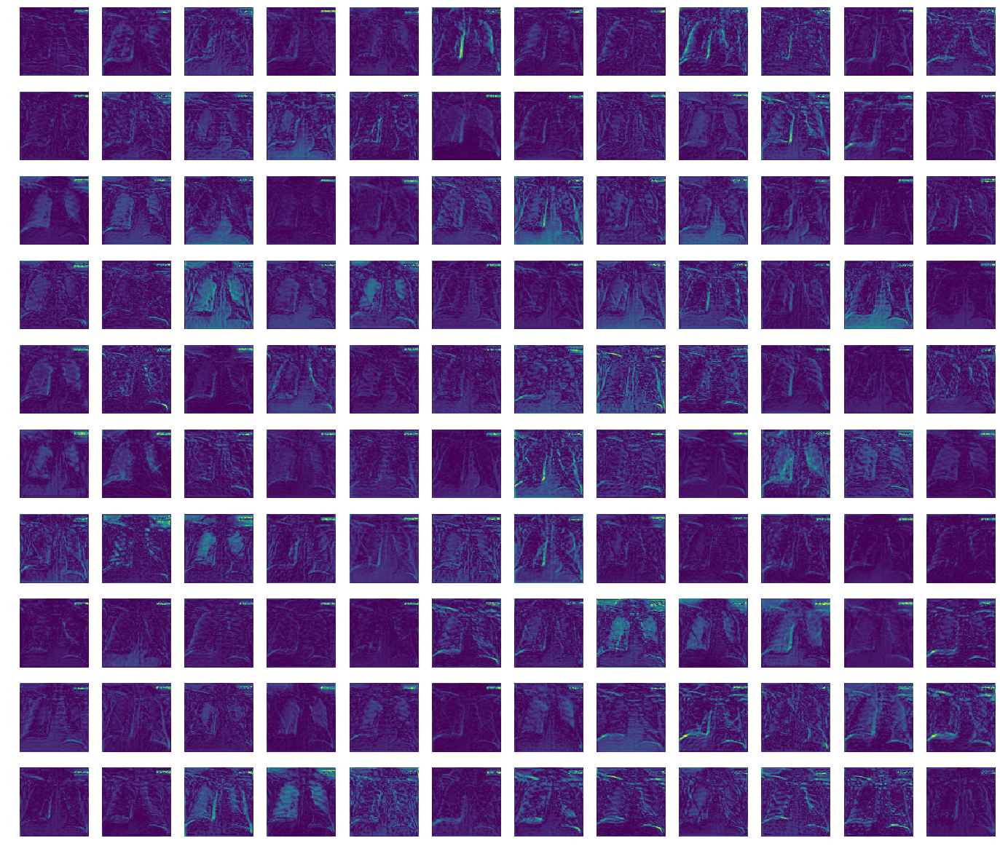

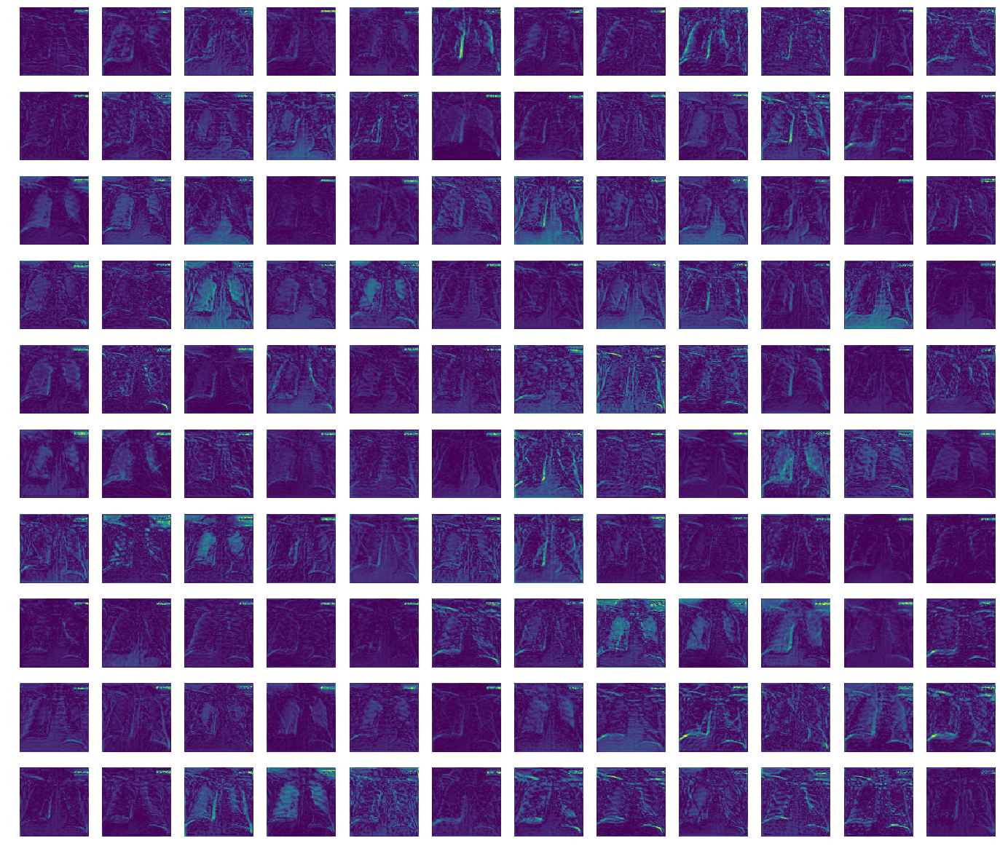

In [120]:
visualize(t1[0][0])
visualize(t2[0][0])
visualize(t3[0][0])

## Visualize gradients

In [121]:
# output probs
out.sigmoid()

tensor([[0.2740, 0.0777, 0.1536, 0.1926, 0.3206]], grad_fn=<SigmoidBackward>)

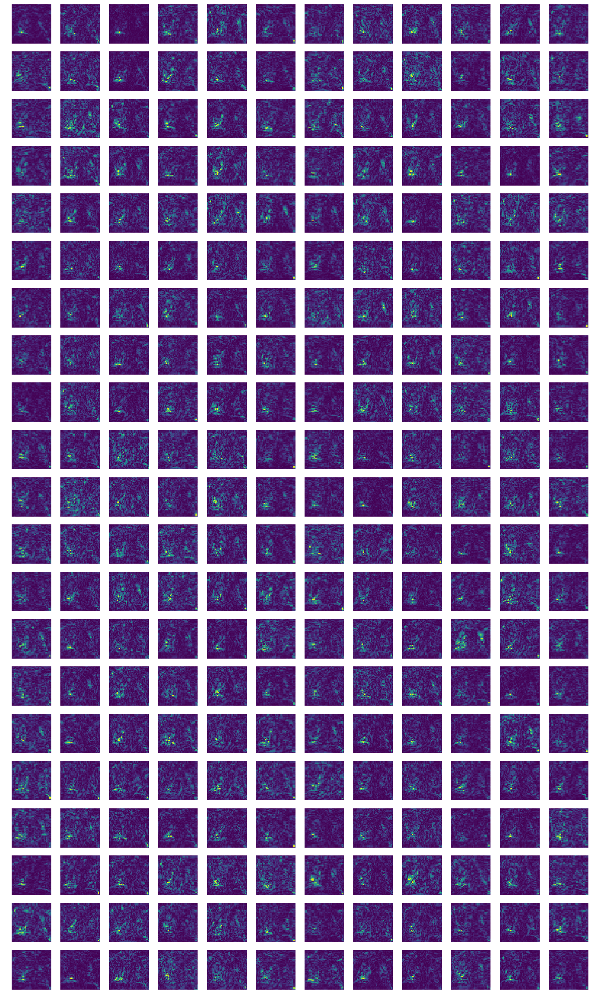

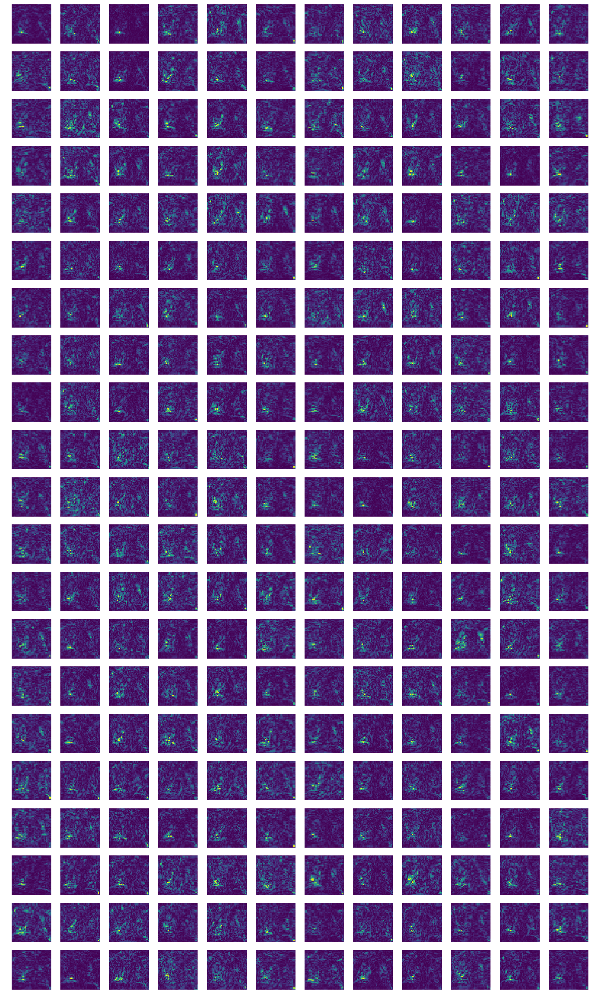

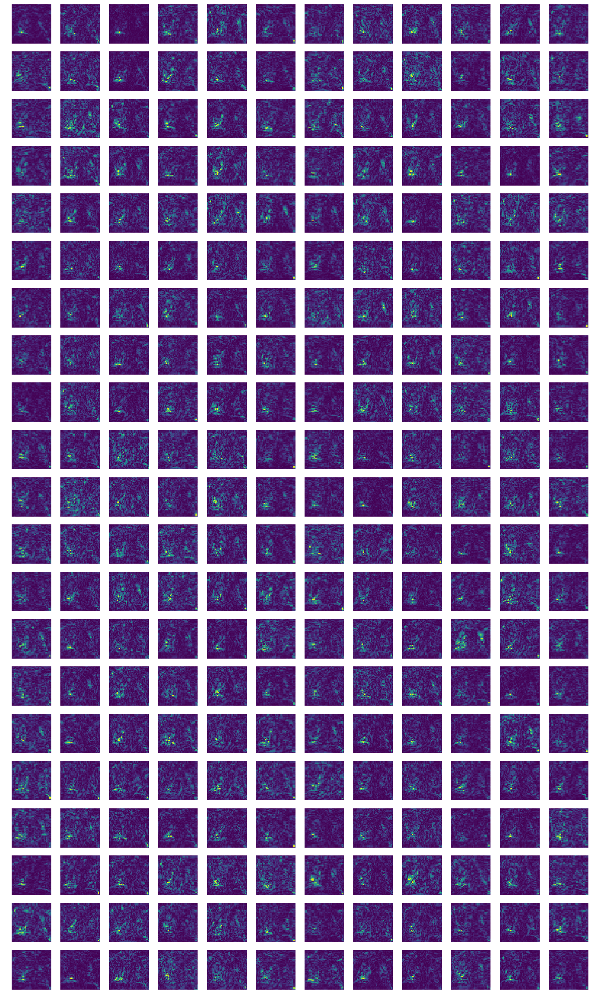

In [122]:
# Class 0 

model.zero_grad()
one_hot = torch.tensor([1,0,0,0,0]).float().requires_grad_(True)
one_hot.mul(out).sum().backward(retain_graph=True)

visualize(bt1[0][0][0])
visualize(bt2[0][0][0])
visualize(bt3[0][0][0])

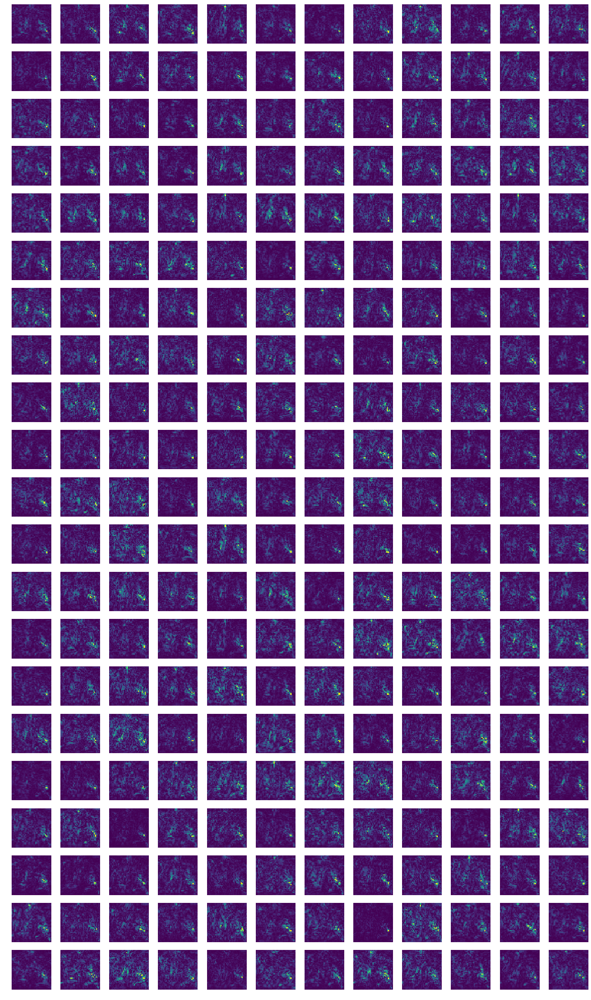

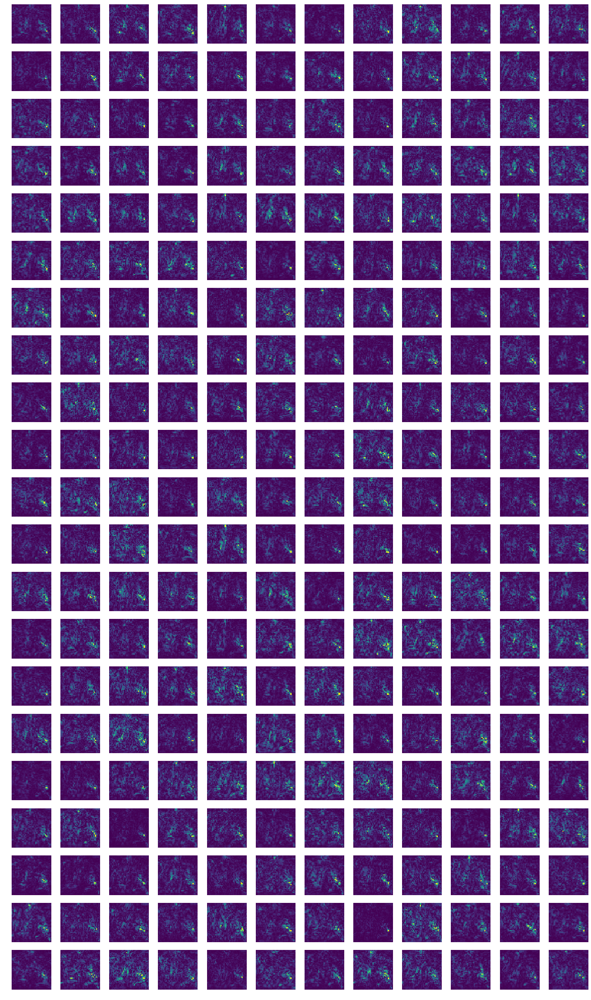

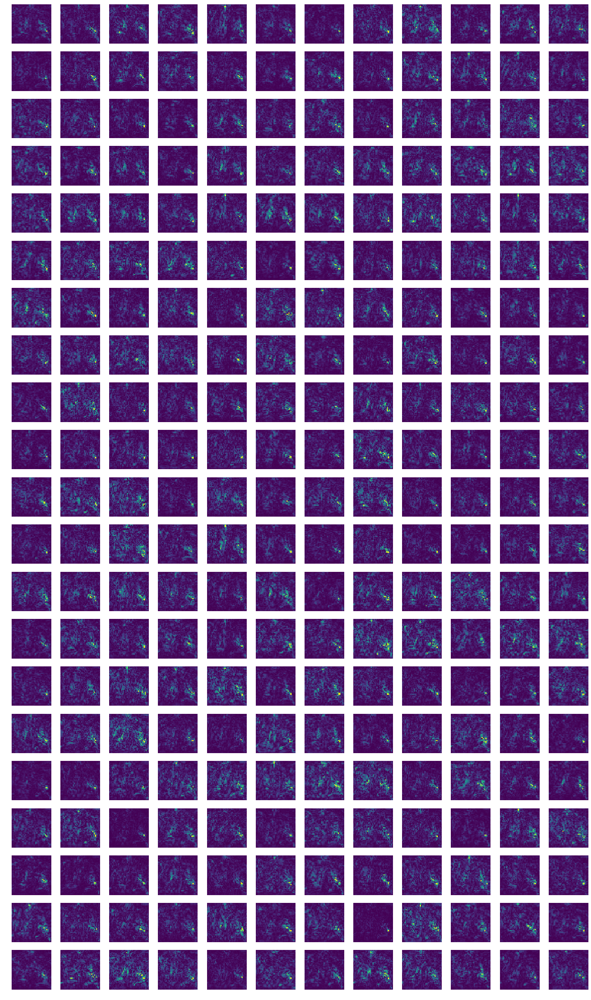

In [123]:
# Class 1

model.zero_grad()
one_hot = torch.tensor([0,1,0,0,0]).float().requires_grad_(True)
one_hot.mul(out).sum().backward(retain_graph=True)

visualize(bt1[1][0][0])
visualize(bt2[1][0][0])
visualize(bt3[1][0][0])

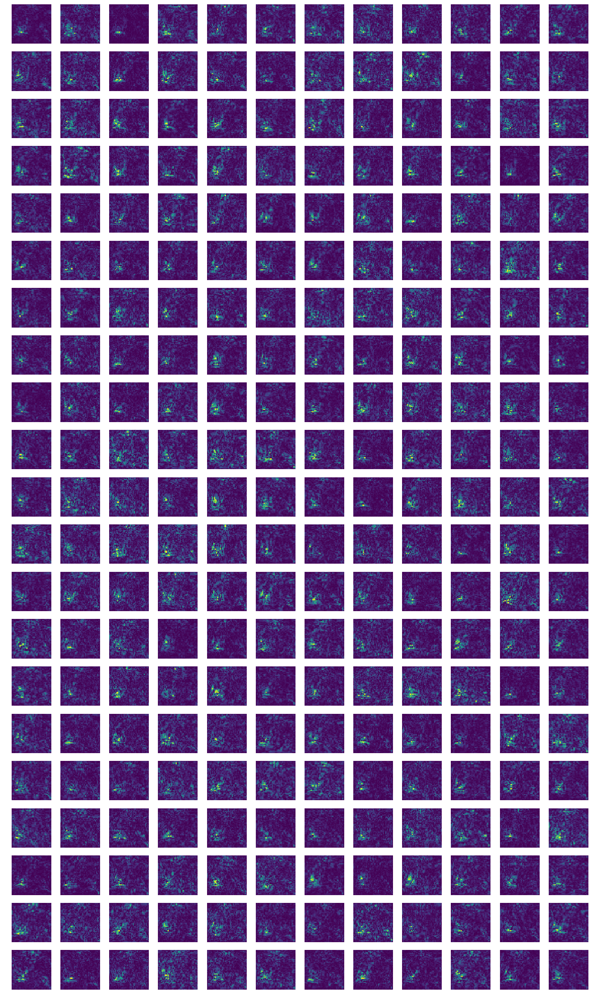

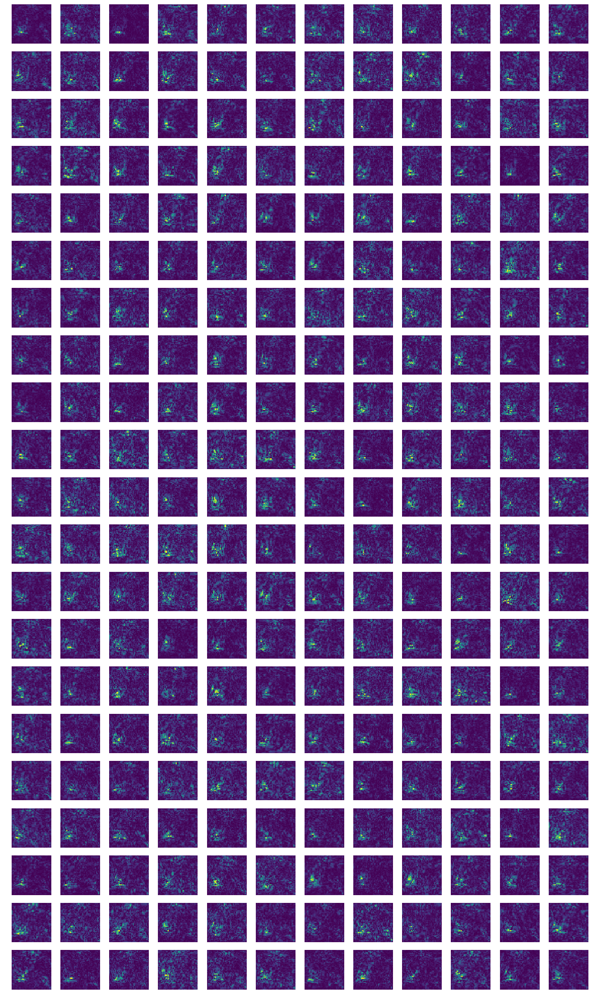

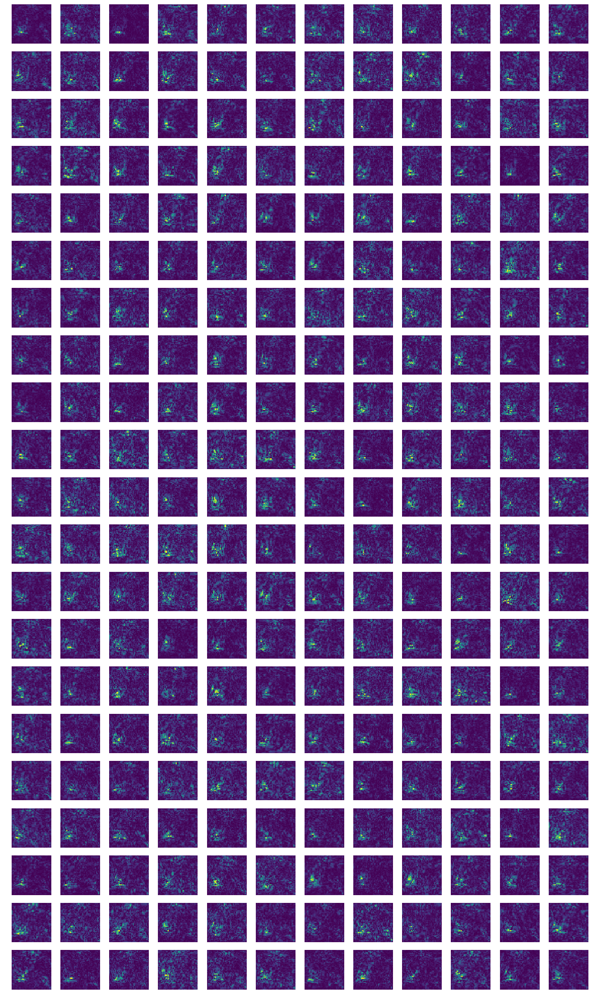

In [124]:
# Class 2

model.zero_grad()
one_hot = torch.tensor([0,0,1,0,0]).float().requires_grad_(True)
one_hot.mul(out).sum().backward(retain_graph=True)

visualize(bt1[2][0][0])
visualize(bt2[2][0][0])
visualize(bt3[2][0][0])

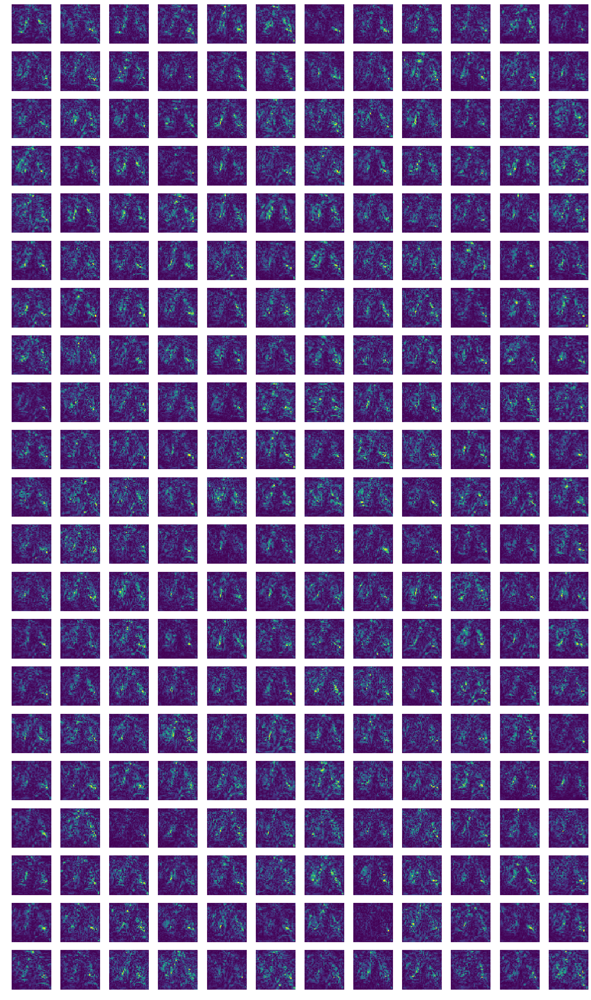

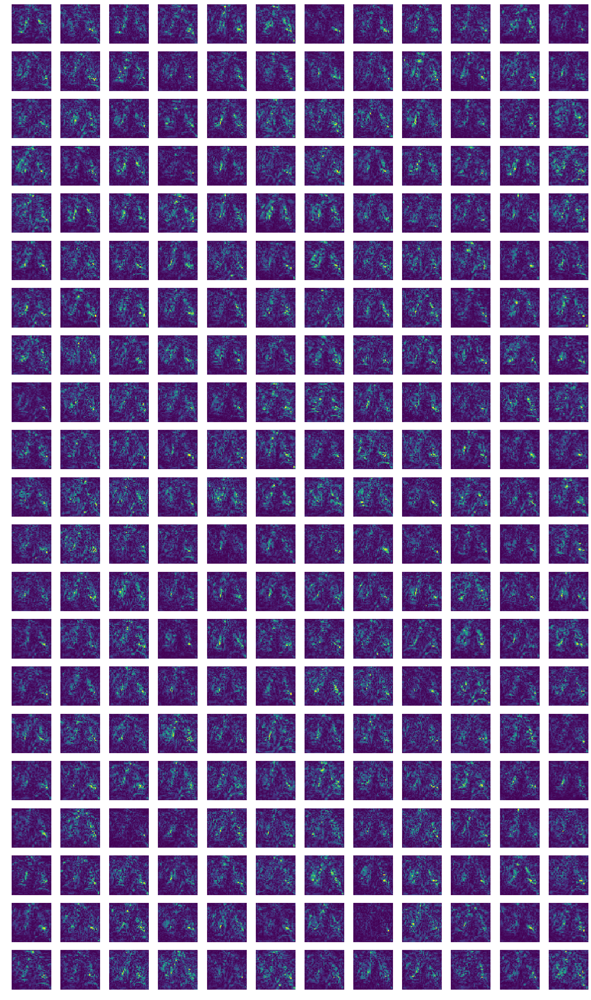

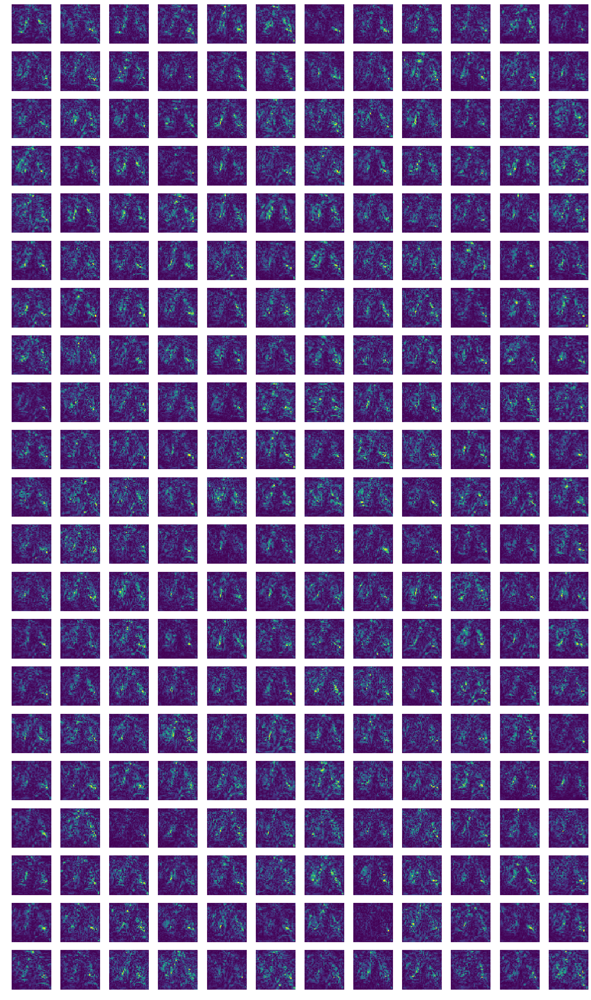

In [125]:
# Class 3

model.zero_grad()
one_hot = torch.tensor([0,0,0,1,0]).float().requires_grad_(True)
one_hot.mul(out).sum().backward(retain_graph=True)

visualize(bt1[3][0][0])
visualize(bt2[3][0][0])
visualize(bt3[3][0][0])

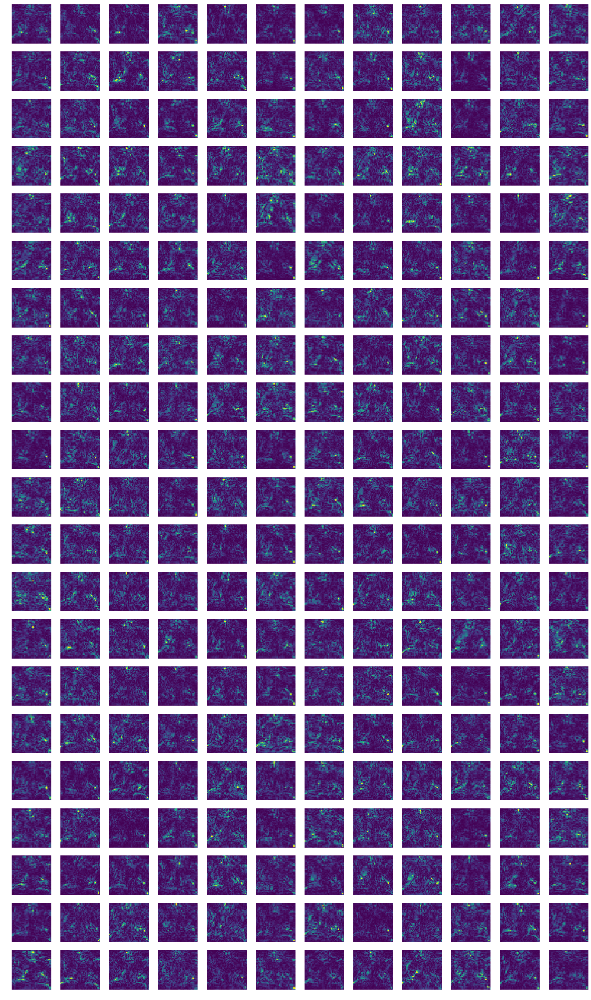

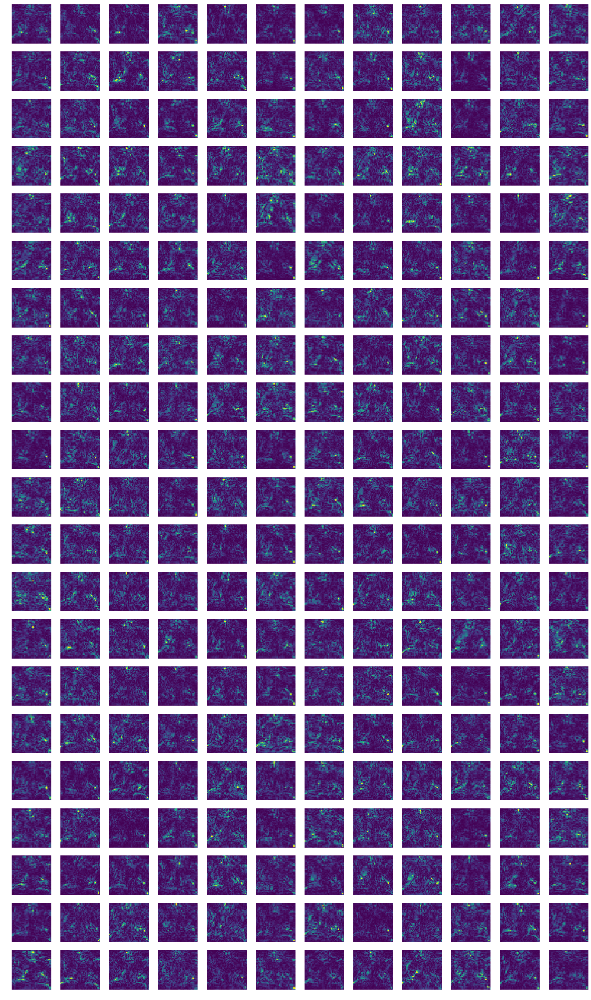

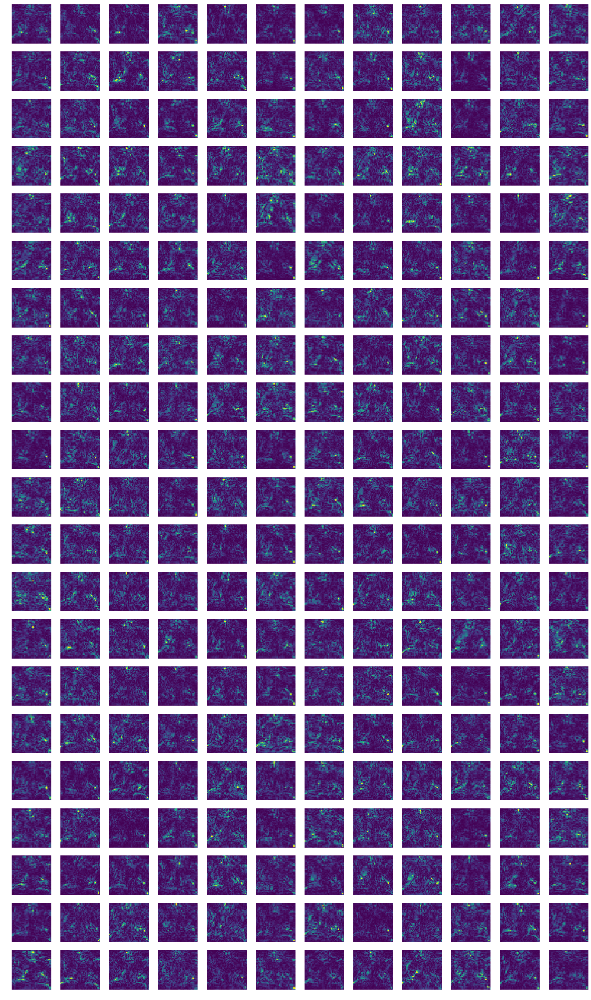

In [126]:
# Class 4

model.zero_grad()
one_hot = torch.tensor([0,0,0,0,1]).float().requires_grad_(True)
one_hot.mul(out).sum().backward(retain_graph=True)

visualize(bt1[4][0][0])
visualize(bt2[4][0][0])
visualize(bt3[4][0][0])